### FUNCTION AND LOOP NOTEBOOK

This notebook focuses on creating a function and loop relevant to our datasets. It uses the vacant lots and community boundaries data from LA City's Open Data Portal.



In [1]:
# to get started, we will import these libraries
import urllib.request, json 
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from sodapy import Socrata

# for interactive plots
import plotly.express as px
import folium

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
# next we will connect to the data portal to load in vacant parcel data from LA County Assessor
client = Socrata("data.lacounty.gov", None)

# The website says this dataset has 176K rows, we are going to try to call in all of them using 180K in case more have been added. However, we are also going to limit our data to Los Angeles incorporated
results = client.get("vcaw-zeg9", limit=180000, where="taxratearea_city=='LOS ANGELES'")

# We'll need to convert to pandas DataFrame
vacdf = pd.DataFrame.from_records(results)

vacdf.sample(5)

,usecodedescchar1,roll_homeownersexemp,situsunit,recordingdate,effectiveyearbuilt,istaxableparcel,roll_totlandimp,roll_perspropexemp,parcelboundarydescription,roll_landbaseyear,...,location_1,bathrooms,sqftmain,situsdirection,roll_realestateexemp,center_lat,situszip,yearbuilt,propertylocation,situszip5
10805,Residential,0,,20001208,0,Y,407470,0,HARRISON CURTIS AND SWEETSER'S SUB OF BLK 18 O...,2001,...,"{'latitude': '34.02519372', 'needs_recoding': ...",0,0,,0,34.02519372,,0,NaN,NaN
6258,Residential,0,,20061031,0,Y,195083,0,*TR=SYLMAR ACRES*1/2 VAC ALLEY ADJ ON NE AND L...,2007,...,"{'latitude': '34.30900896', 'needs_recoding': ...",0,0,,0,34.30900896,,0,NaN,NaN
7012,Residential,0,,20081023,0,Y,1027,0,PARCEL MAP AS PER BK 182 P 6-8 OF P M* POR OF ...,2009,...,"{'latitude': '34.22013252', 'needs_recoding': ...",0,0,,0,34.22013252,,0,NaN,NaN
22649,Residential,0,,20101208,0,Y,68010,0,TRACT NO 9449 LOT 88,2011,...,"{'latitude': '34.11925247', 'needs_recoding': ...",0,0,,0,34.11925247,,0,NaN,NaN
11116,Residential,0,,20090930,0,Y,6444189,0,TR=6073 FOR DESC SEE ASSESSOR'S MAPS POR OF LO...,2010,...,"{'latitude': '34.09229003', 'needs_recoding': ...",0,0,,0,34.09229003,90210-2129,0,9941 TOWER LANE LOS ANGELES CA 90210,90210


dope! it worked again! Now we will see all the data.

In [3]:
vacdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33091 entries, 0 to 33090
Data columns (total 51 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   usecodedescchar1           33080 non-null  object
 1   roll_homeownersexemp       33091 non-null  object
 2   situsunit                  33091 non-null  object
 3   recordingdate              33091 non-null  object
 4   effectiveyearbuilt         33091 non-null  object
 5   istaxableparcel            33091 non-null  object
 6   roll_totlandimp            33091 non-null  object
 7   roll_perspropexemp         33091 non-null  object
 8   parcelboundarydescription  33091 non-null  object
 9   roll_landbaseyear          33091 non-null  object
 10  situscity                  33091 non-null  object
 11  roll_impbaseyear           33091 non-null  object
 12  usetype                    33080 non-null  object
 13  cluster                    33091 non-null  object
 14  adminr

In [4]:
#reproject both datasets so I can add basemaps later when creating the loop

vacgdf = gpd.GeoDataFrame(vacdf, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(vacdf.center_lon, vacdf.center_lat))

In [5]:
# import the community boundaries dataset by referencing API from data source

import shapely
from shapely.geometry import shape

comdf = pd.read_json( r'https://data.lacounty.gov/resource/frhs-h972.json' )
comdf['the_geom'] = comdf['the_geom'].apply(shape)
comgdf = gpd.GeoDataFrame(comdf).set_geometry('the_geom')

comgdf.sample(5)

,objectid,city_type,lcity,label,source,shape_starea,shape_stlength,the_geom,community
69,33,City,Huntington Park,City of Huntington Park,BOS,8.404275e+07,66385.785322,"MULTIPOLYGON (((-118.20416 33.98896, -118.2041...",NaN
221,200,City,Rolling Hills Estates,City of Rolling Hills Estates,BOS,1.002431e+08,122666.539953,"MULTIPOLYGON (((-118.35105 33.79521, -118.3501...",NaN
311,16,City,Claremont,City of Claremont,BOS,3.754566e+08,150126.117964,"MULTIPOLYGON (((-117.71585 34.16538, -117.7157...",NaN
36,136,City,Los Angeles,Los Angeles - Rancho Park,LA City,2.347476e+07,22114.702118,"MULTIPOLYGON (((-118.42465 34.04194, -118.4242...",Rancho Park
73,297,Unincorporated,Unincorporated,Unincorporated - Rancho Dominguez,BOS,7.530105e+07,41412.454709,"MULTIPOLYGON (((-118.20619 33.87046, -118.2061...",Rancho Dominguez


In [6]:
# gives us all the columns and rows for community boundaries
comgdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 348 entries, 0 to 347
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   objectid        348 non-null    int64   
 1   city_type       348 non-null    object  
 2   lcity           348 non-null    object  
 3   label           348 non-null    object  
 4   source          348 non-null    object  
 5   shape_starea    348 non-null    float64 
 6   shape_stlength  348 non-null    float64 
 7   the_geom        348 non-null    geometry
 8   community       261 non-null    object  
dtypes: float64(2), geometry(1), int64(1), object(5)
memory usage: 24.6+ KB


Now, we will project the community boundaries to the same epsg to add the basemap later.

In [7]:
comgdf = comgdf.set_crs('epsg:4326')

In [8]:
comgdf.head()

,objectid,city_type,lcity,label,source,shape_starea,shape_stlength,the_geom,community
0,1,City,Agoura Hills,City of Agoura Hills,BOS,2.179401e+08,80374.083443,"MULTIPOLYGON (((-118.72864 34.16793, -118.7286...",NaN
1,214,City,Temple City,City of Temple City,BOS,1.122325e+08,60506.140608,"MULTIPOLYGON (((-118.05659 34.11841, -118.0563...",NaN
2,95,City,Los Angeles,Los Angeles - Harvard Heights,LA City,2.089842e+07,21077.385705,"MULTIPOLYGON (((-118.29156 34.04000, -118.2923...",Harvard Heights
3,334,Unincorporated,Unincorporated,Unincorporated - Westfield/Academy Hills,BOS,1.459186e+07,17831.004587,"MULTIPOLYGON (((-118.34845 33.77939, -118.3488...",Westfield/Academy Hills
4,55,City,Los Angeles,Los Angeles - Beverly Crest,LA City,2.342333e+08,110820.548509,"MULTIPOLYGON (((-118.40751 34.12945, -118.4074...",Beverly Crest


In [9]:
# it all all looks good so far 

#lets see the columns and rows
comgdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 348 entries, 0 to 347
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   objectid        348 non-null    int64   
 1   city_type       348 non-null    object  
 2   lcity           348 non-null    object  
 3   label           348 non-null    object  
 4   source          348 non-null    object  
 5   shape_starea    348 non-null    float64 
 6   shape_stlength  348 non-null    float64 
 7   the_geom        348 non-null    geometry
 8   community       261 non-null    object  
dtypes: float64(2), geometry(1), int64(1), object(5)
memory usage: 24.6+ KB


In our past notebook we narrowed down our scope to certain communities: Westlake, Echo Park, Baldwin Hills, Chinatown, East Hollywood, Lincoln Heights, El Sereno, Angelino Distrcit, Silverlake, and Crenshaw. 

In [10]:
# this is our new dataframe that we will use to create a loop

com_new = comgdf.loc[[68,134,152,123,116, 21, 95, 262, 228, 198 ]]

In [30]:
def vacantparcel_map(community = 'Crenshaw District', column = 'usecodedescchar1'):
    # neighborhood
    
    neighb = comgdf[comgdf['community']==community]
    
    # spatial join to get vacant lots
    vacmap = gpd.sjoin(vacgdf,neighb)

    # plot vacant lots
    fig,ax = plt.subplots(figsize=(30,35))
    
    # plot neighborhood boundaries
    neighb.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.2)

    # map
    vacmap.plot(ax=ax,
                column=column,
                legend=True,
               legend_kwds={'loc':'upper right','fontsize': '25','bbox_to_anchor':(1,.9)})

    ax.axis('off')
    ax.set_title('Vacant Parcels in ' + community + ' Neighborhood', fontsize=50)
    
    #add basemap
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager, crs=comgdf.crs)

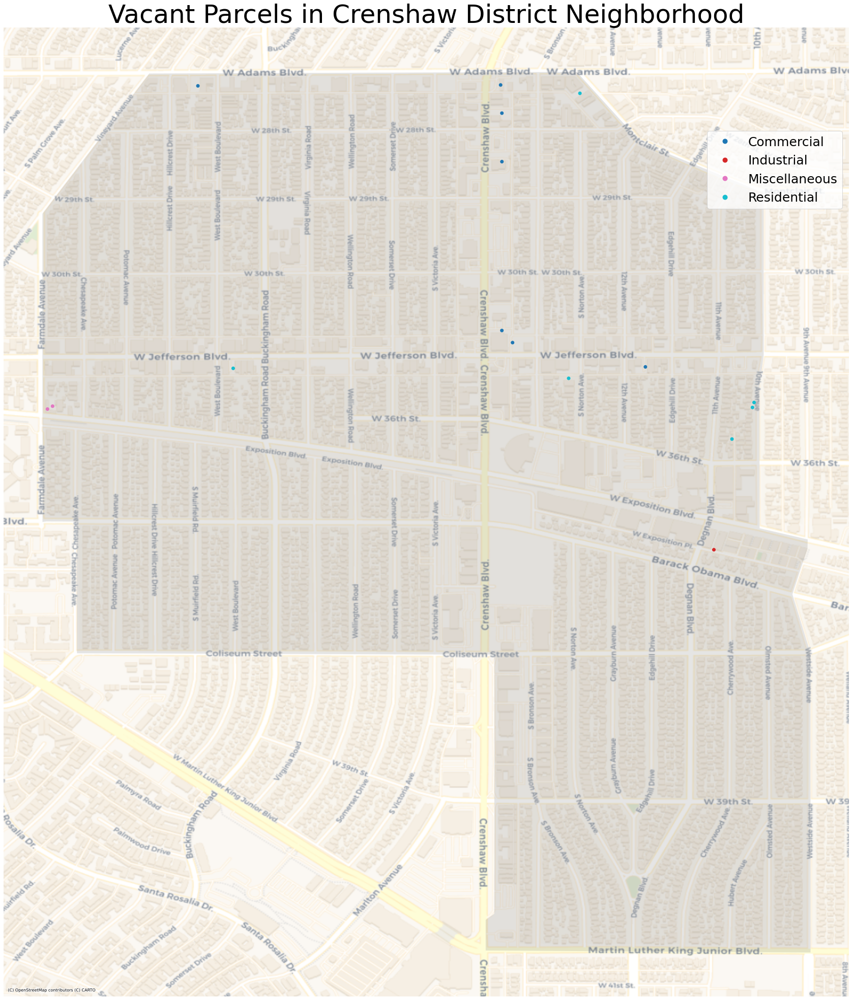

In [31]:
#check that it works
vacantparcel_map()

plt.savefig('Crenshaw District_loop.png', bbox_inches='tight')

We have been trying to see what map can fit best to highlight the types of vacant lots.

Here we see Boyle heights with mostly residential allocated lots. Through this we also assume that the xoning policies are mostly residential towards the north and industrial the more south we go. We had tried to use the LA Zoning data, and are still currently trying to explore with it. 

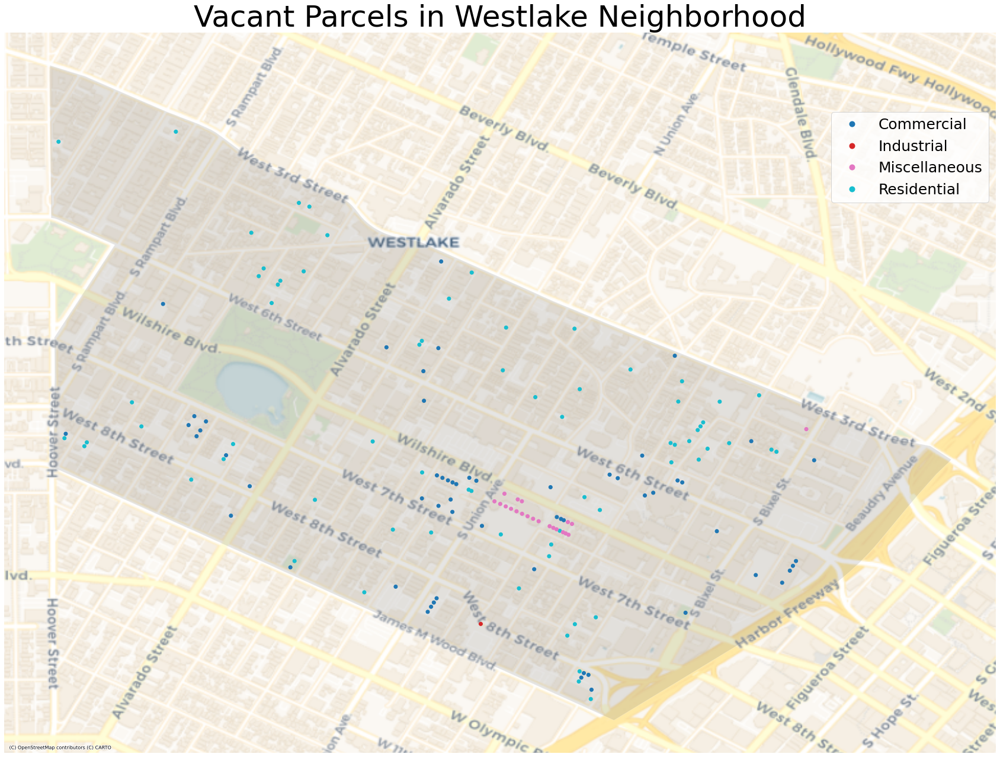

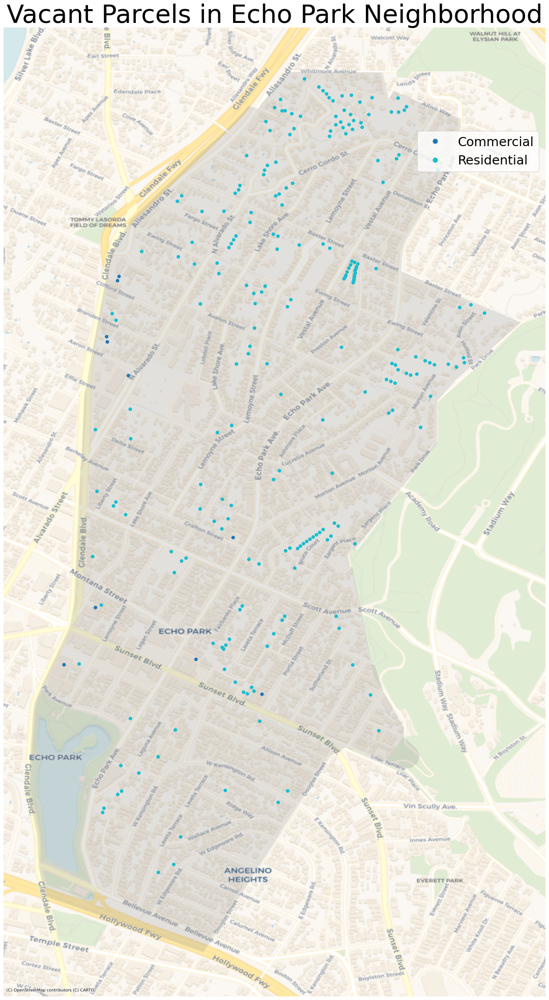

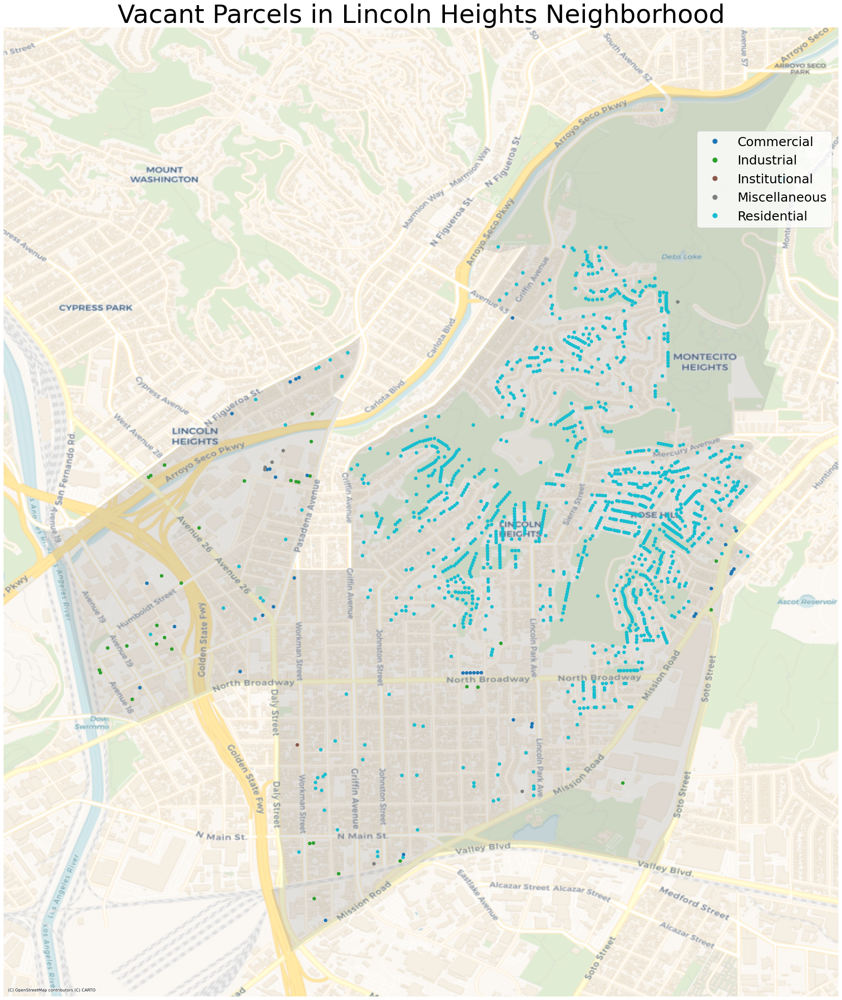

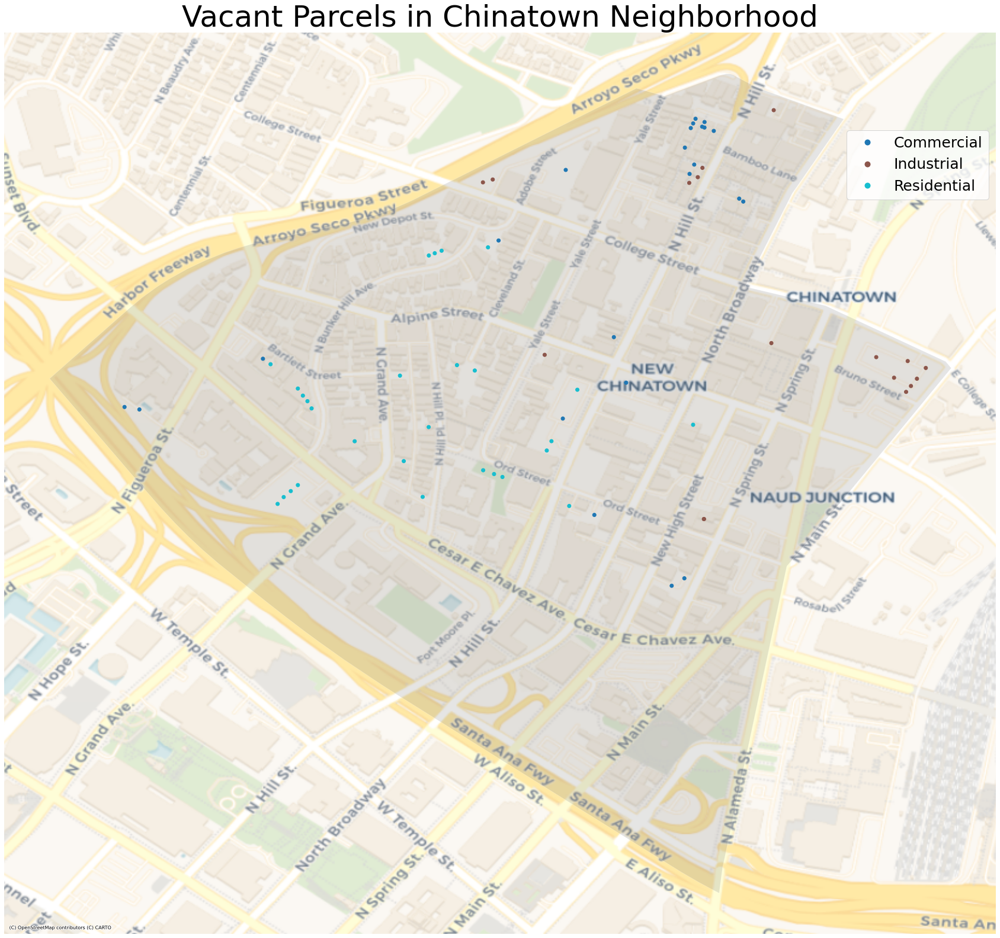

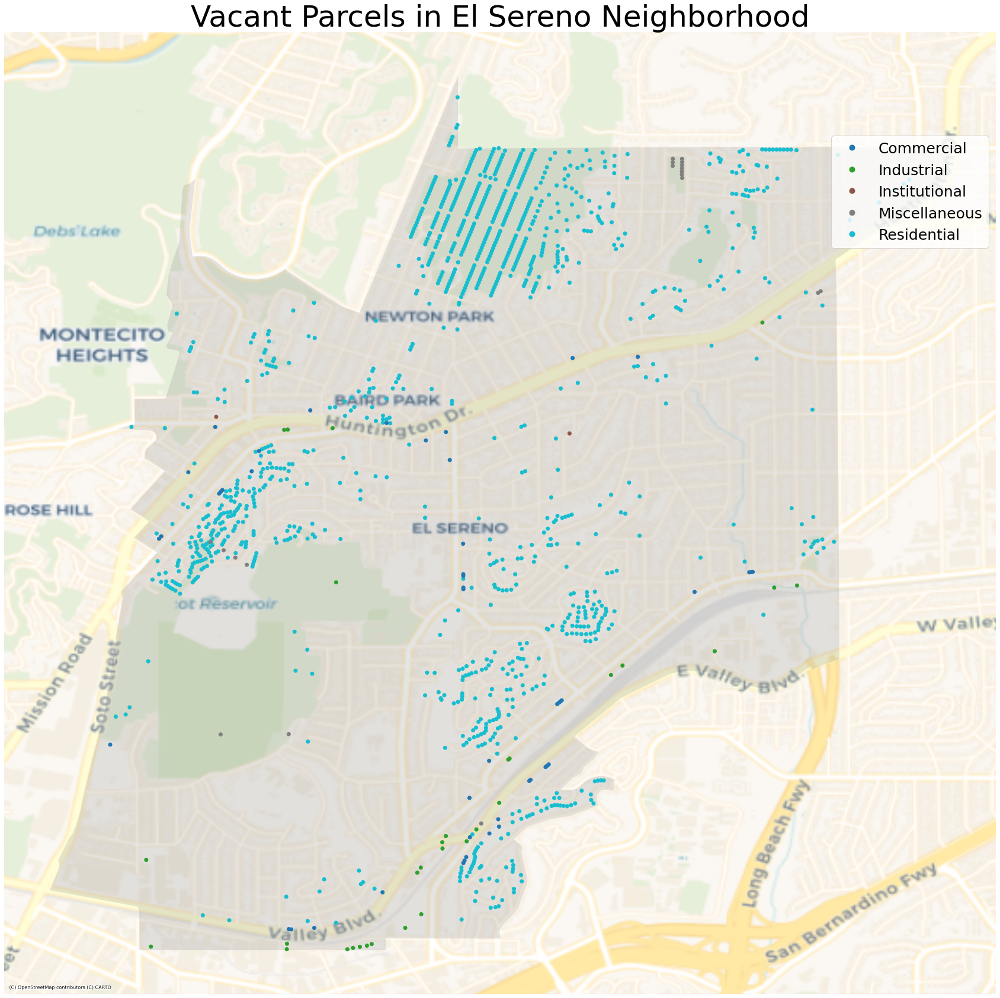

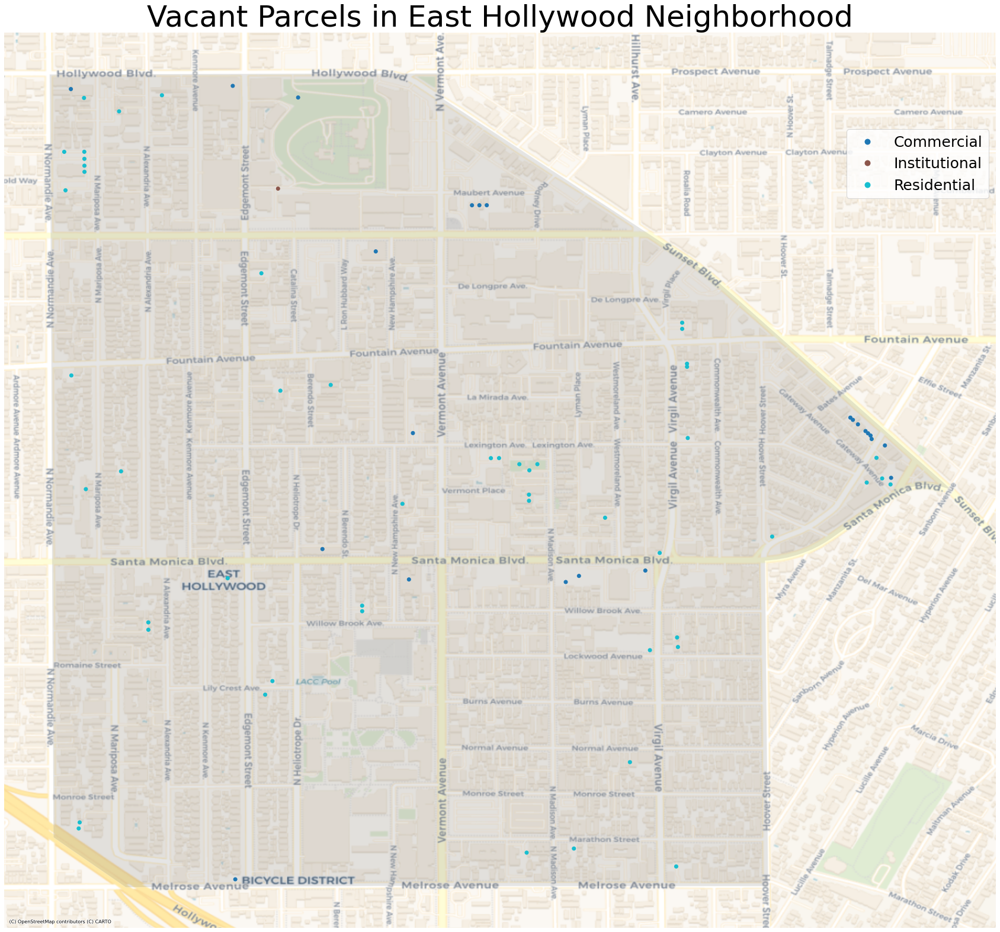

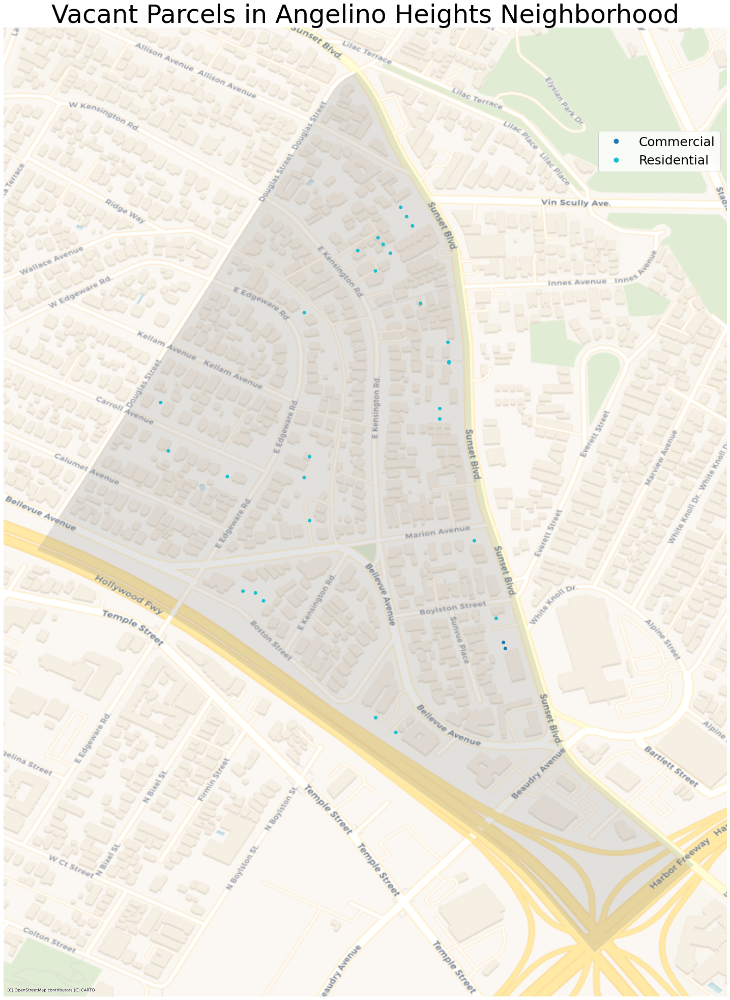

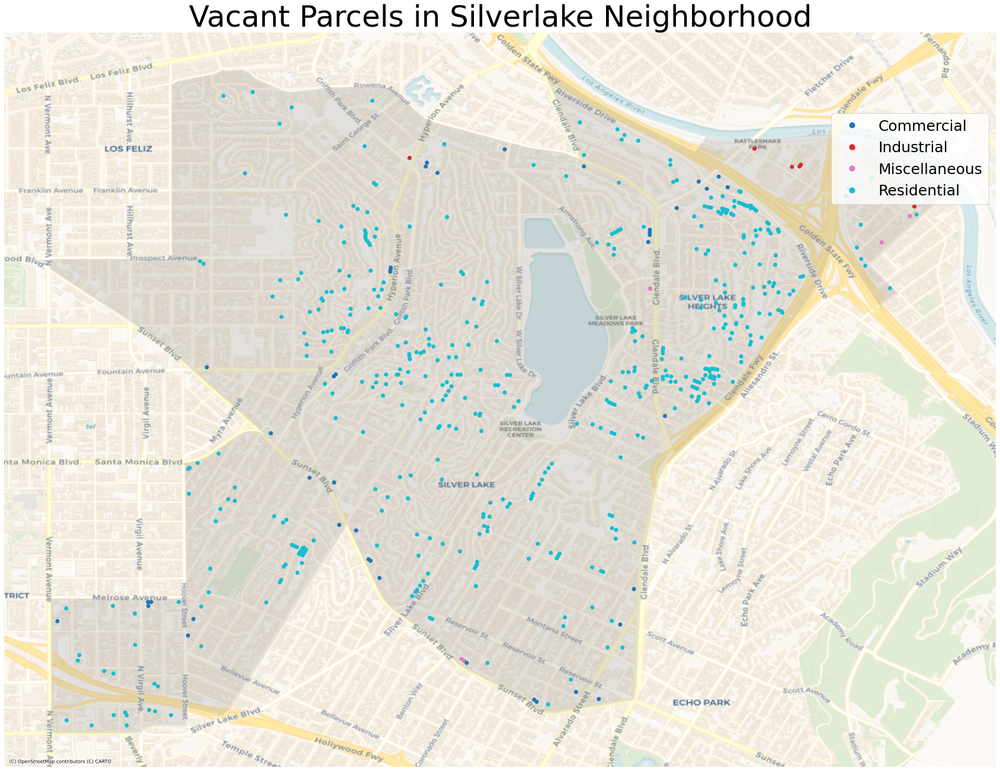

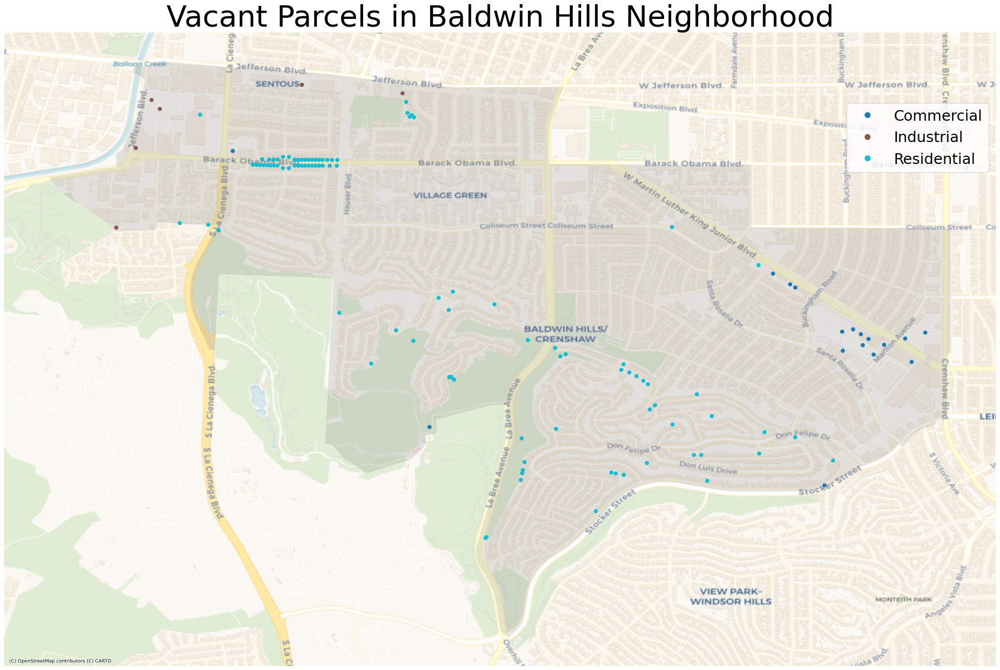

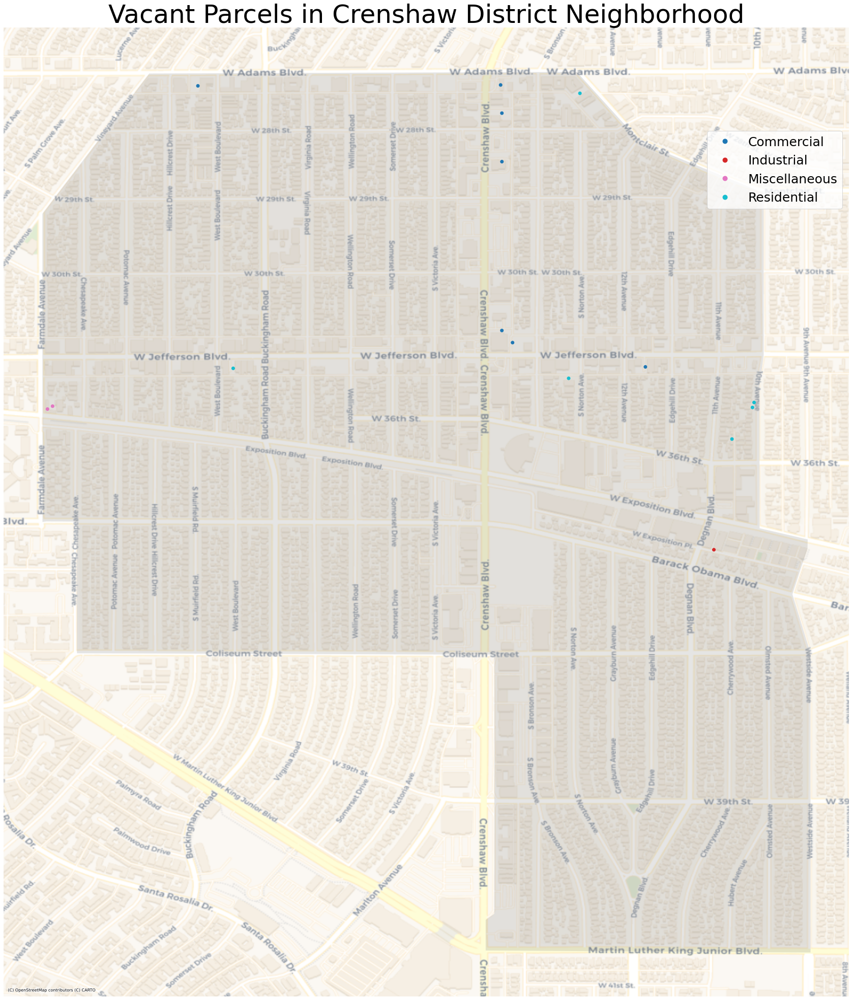

In [14]:
#loop through the community neighborhoods 
for index, row in com_new.iterrows():
    vacantparcel_map(community = row['community'])

Most of these neighborhoods have a large number of vacant lots allocated for residential use. It be interested to dive deeper to see if there are any development plans already proposed, possibly see if there are any "affordable housing" projects being secured.

It will also be interesting to see the propoerty/ homeownership by demographics. 

### Designated Tasks

Lupe: Narrow down dataframe & begin the function, clean the notebooks and support markdowns. 
    
    
Mel: Finalize function and loop clean the code 

In [16]:
print (dir)

<built-in function dir>


In [4]:
ctx.providers

{'OpenStreetMap': {'Mapnik': {'url': 'https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.Mapnik'},
  'DE': {'url': 'https://{s}.tile.openstreetmap.de/tiles/osmde/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.DE'},
  'CH': {'url': 'https://tile.osm.ch/switzerland/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'bounds': [[45, 5], [48, 11]],
   'name': 'OpenStreetMap.CH'},
  'France': {'url': 'https://{s}.tile.openstreetmap.fr/osmfr/{z}/{x}/{y}.png',
   'max_zoom': 20,
   'html_attribution': '&copy; OpenStreetMap France | &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap France | (C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.France'},
  'HOT': {'url': 'https://{s}.tile.openstreetmap.fr/hot/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors, Tiles style by <a href="https://www.hotosm.org/" target="_blank">Humanitarian OpenStreetMap Team</a> hosted by <a href="https://openstreetmap.fr/" target="_blank">OpenStreetMap France</a>',
   'attribution': '(C) OpenStreetMap contributors, Tiles style by Humanitarian OpenStreetMap Team hosted by OpenStreetMap France',
   'name': 'OpenStreetMap.HOT'},
  'BZH': {'url': 'https://tile.openstreetmap.bzh/br/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors, Tiles courtesy of <a href="http://www.openstreetmap.bzh/" target="_blank">Breton OpenStreetMap Team</a>',
   'attribution': '(C) OpenStreetMap contributors, Tiles courtesy of Breton OpenStreetMap Team',
   'bounds': [[46.2, -5.5], [50, 0.7]],
   'name': 'OpenStreetMap.BZH'},
  'BlackAndWhite': {'url': 'http://{s}.tiles.wmflabs.org/bw-mapnik/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'attribution': '(C) OpenStreetMap contributors',
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'name': 'OpenStreetMap.BlackAndWhite'}},
 'OpenSeaMap': {'url': 'https://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
  'html_attribution': 'Map data: &copy; <a href="http://www.openseamap.org">OpenSeaMap</a> contributors',
  'attribution': 'Map data: (C) OpenSeaMap contributors',
  'name': 'OpenSeaMap'},
 'OPNVKarte': {'url': 'https://tileserver.memomaps.de/tilegen/{z}/{x}/{y}.png',
  'max_zoom': 18,
  'html_attribution': 'Map <a href="https://memomaps.de/">memomaps.de</a> <a href="http://creativecommons.org/licenses/by-sa/2.0/">CC-BY-SA</a>, map data &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
  'attribution': 'Map memomaps.de CC-BY-SA, map data (C) OpenStreetMap contributors',
  'name': 'OPNVKarte'},
 'OpenTopoMap': {'url': 'https://{s}.tile.opentopomap.org/{z}/{x}/{y}.png',
  'max_zoom': 17,
  'html_attribution': 'Map data: &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors, <a href="http://viewfinderpanoramas.org">SRTM</a> | Map style: &copy; <a href="https://opentopomap.org">OpenTopoMap</a> (<a href="https://creativecommons.org/licenses/by-sa/3.0/">CC-BY-SA</a>)',
  'attribution': 'Map data: (C) OpenStreetMap contributors, SRTM | Map style: (C) OpenTopoMap (CC-BY-SA)',
  'name': 'OpenTopoMap'},
 'OpenRailwayMap': {'url': 'https://{s}.tiles.openrailwaymap.org/standard/{z}/{x}/{y}.png',
  'max_